# **Sales Price Study**

## Objectives

Answer Business Requirement 1:
* The client is interested in discovering how the house attributes correlate with the sale price. Therefore, the client expects data visualisations of the correlated variables against the sale price to show that.

## Inputs

* outputs/datasets/cleaned/clean_pipeline.csv

## Outputs

* Generate code and conclusion that answers Business Requirement 1.
* PNG files which can be use in Streamlit.
* Response to hypothesys 1 & 2.

## Conclusion

* 9 features have a high correlation with the target SalePrice: [more info](#conclusions).


---

# Change working directory

We need to change the working directory from its current folder to its parent folder
* We access the current directory with os.getcwd()

In [1]:
import os
current_dir = os.getcwd()
current_dir

'/workspace/Prediction-heritage-housing/jupyter_notebooks'

We want to make the parent of the current directory the new current directory
* os.path.dirname() gets the parent directory
* os.chir() defines the new current directory

In [2]:
os.chdir(os.path.dirname(current_dir))
print("You set a new current directory")

You set a new current directory


Confirm the new current directory

In [3]:
current_dir = os.getcwd()
current_dir

'/workspace/Prediction-heritage-housing'

# Load Data

In [4]:
import pandas as pd
df = pd.read_csv("outputs/datasets/cleaned/clean_pipeline.csv")
df.head(8)

,1stFlrSF,2ndFlrSF,BedroomAbvGr,BsmtExposure,BsmtFinSF1,BsmtFinType1,BsmtUnfSF,GarageArea,GarageFinish,GarageYrBlt,...,LotArea,LotFrontage,MasVnrArea,OpenPorchSF,OverallCond,OverallQual,TotalBsmtSF,YearBuilt,YearRemodAdd,SalePrice
0,856,854.000000,3.000000,No,706,GLQ,150,548,RFn,2003.0,...,8450,65.000000,196.0,61,5,7,856,2003,2003,208500
1,1262,0.000000,3.000000,Gd,978,ALQ,284,460,RFn,1976.0,...,9600,80.000000,0.0,0,8,6,1262,1976,1976,181500
2,920,866.000000,3.000000,Mn,486,GLQ,434,608,RFn,2001.0,...,11250,68.000000,162.0,42,5,7,920,2001,2002,223500
3,961,348.524017,2.869214,No,216,ALQ,540,642,Unf,1998.0,...,9550,60.000000,0.0,35,5,7,756,1915,1970,140000
4,1145,348.524017,4.000000,Av,655,GLQ,490,836,RFn,2000.0,...,14260,84.000000,350.0,84,5,8,1145,2000,2000,250000
5,796,566.000000,1.000000,No,732,GLQ,64,480,Unf,1993.0,...,14115,85.000000,0.0,30,5,5,796,1993,1995,143000
6,1694,0.000000,3.000000,Av,1369,GLQ,317,636,RFn,2004.0,...,10084,75.000000,186.0,57,5,8,1686,2004,2005,307000
7,1107,983.000000,3.000000,Mn,859,ALQ,216,484,Missing,1973.0,...,10382,70.049958,240.0,204,6,7,1107,1973,1973,200000


---

# Data Exploration

To become more familiar with the data, thanks to a Pandas profile report:

In [5]:
from ydata_profiling import ProfileReport
pandas_report = ProfileReport(df)
pandas_report.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Thanks to the above report: 
* We can confirm that no more missing variables are present.
* We have 22 variables which include 18 numerical variables and 4 categorical variables.
* When checking SalePrice specifically we see : 
  * a kurtosis of 0.6 indicates that the distribution is less peaked and has lighter tails compared to a normal distribution.
  * a skewness of 1.88 indicates that the distribution is "skewed" towards higher values.
  * the strongest correlation seems to be with **OverallQual**.

---

# Correlation Study & PPS analysis

We are now going to do both correlation studies (Spearman and pearson) and a PPS analysys to use the best of these approches:
* the Spearman correlation measures the monotonic relationship between two variables to reveal a general trend.
* the Pearson correlation (or r coefficient) measures the linear relationship between two continuous variables.
* the PPS analysys detects linear or non-linear relationships between two columns.

The custom function below was taken from the *Predictive Power Score Unit 1: Introduction* notebook:

In [6]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import ppscore as pps

def heatmap_corr(df,threshold, figsize=(20,12), font_annot = 8):
  if len(df.columns) > 1:
    mask = np.zeros_like(df, dtype=np.bool)
    mask[np.triu_indices_from(mask)] = True
    mask[abs(df) < threshold] = True

    fig, axes = plt.subplots(figsize=figsize)
    sns.heatmap(df, annot=True, xticklabels=True, yticklabels=True,
                mask=mask, cmap='viridis', annot_kws={"size": font_annot}, ax=axes,
                linewidth=0.5
                     )
    axes.set_yticklabels(df.columns, rotation = 0)
    plt.ylim(len(df.columns),0)
    plt.show()


def heatmap_pps(df,threshold, figsize=(20,12), font_annot = 8):
    if len(df.columns) > 1:

      mask = np.zeros_like(df, dtype=np.bool)
      mask[abs(df) < threshold] = True

      fig, ax = plt.subplots(figsize=figsize)
      ax = sns.heatmap(df, annot=True, xticklabels=True,yticklabels=True,
                       mask=mask,cmap='rocket_r', annot_kws={"size": font_annot},
                       linewidth=0.05,linecolor='grey')
      
      plt.ylim(len(df.columns),0)
      plt.show()



def CalculateCorrAndPPS(df):
  """
  Calculate correlation tables and PPS table for a dataset. 
  This function prints Q1 and Q3 for PPS scores already.
  """
  df_corr_spearman = df.corr(method="spearman")
  df_corr_pearson = df.corr(method="pearson")

  pps_matrix_raw = pps.matrix(df)
  pps_matrix = pps_matrix_raw.filter(['x', 'y', 'ppscore']).pivot(columns='x', index='y', values='ppscore')

  pps_score_stats = pps_matrix_raw.query("ppscore < 1").filter(['ppscore']).describe().T
  print("PPS threshold - check PPS score IQR to decide threshold for heatmap \n")
  print(pps_score_stats.round(3))

  return df_corr_pearson, df_corr_spearman, pps_matrix


def DisplayCorrAndPPS(df_corr_pearson, df_corr_spearman, pps_matrix,CorrThreshold,PPS_Threshold,
                      figsize=(20,12), font_annot=8 ):

  print("\n")
  print("* Analyze how the target variable for your ML models are correlated with other variables (features and target)")
  print("* Analyze multi colinearity, that is, how the features are correlated among themselves")

  print("\n")
  print("*** Heatmap: Spearman Correlation ***")
  print("It evaluates monotonic relationship \n")
  heatmap_corr(df=df_corr_spearman, threshold=CorrThreshold, figsize=figsize, font_annot=font_annot)

  print("\n")
  print("*** Heatmap: Pearson Correlation ***")
  print("It evaluates the linear relationship between two continuous variables \n")
  heatmap_corr(df=df_corr_pearson, threshold=CorrThreshold, figsize=figsize, font_annot=font_annot)

  print("\n")
  print("*** Heatmap: Predictive power Score (PPS) ***")
  print(f"PPS detects linear or non-linear relationships between two columns.\n"
        f"The score ranges from 0 (no predictive power) to 1 (perfect predictive power) \n")
  heatmap_pps(df=pps_matrix,threshold=PPS_Threshold, figsize=figsize, font_annot=font_annot)

We will now calculate the necessary correlation/PPS tables:

In [7]:
df_corr_pearson, df_corr_spearman, pps_matrix = CalculateCorrAndPPS(df)

PPS threshold - check PPS score IQR to decide threshold for heatmap 

         count   mean    std  min  25%    50%    75%    max
ppscore  462.0  0.061  0.105  0.0  0.0  0.001  0.082  0.629


And display the heatmaps whith a threshold of 0.5 for the correlation studies and 0.2 for the PPS analysys:



* Analyze how the target variable for your ML models are correlated with other variables (features and target)
* Analyze multi colinearity, that is, how the features are correlated among themselves


*** Heatmap: Spearman Correlation ***
It evaluates monotonic relationship 



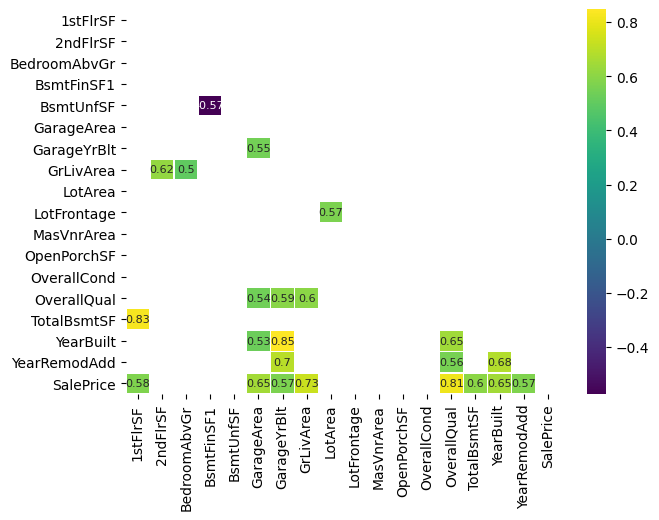



*** Heatmap: Pearson Correlation ***
It evaluates the linear relationship between two continuous variables 



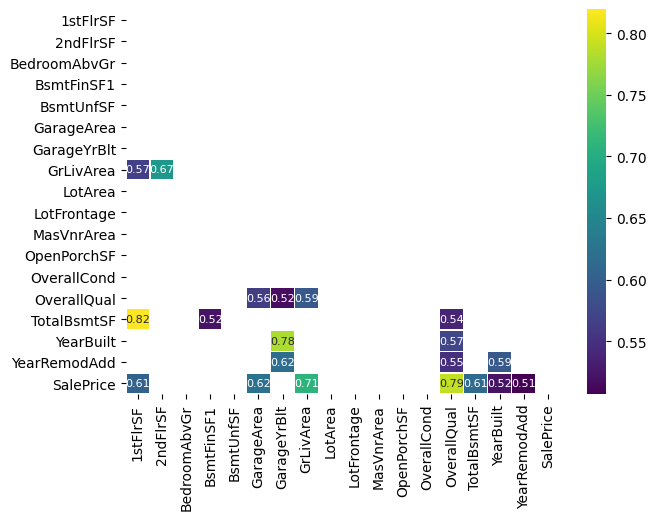



*** Heatmap: Predictive power Score (PPS) ***
PPS detects linear or non-linear relationships between two columns.
The score ranges from 0 (no predictive power) to 1 (perfect predictive power) 



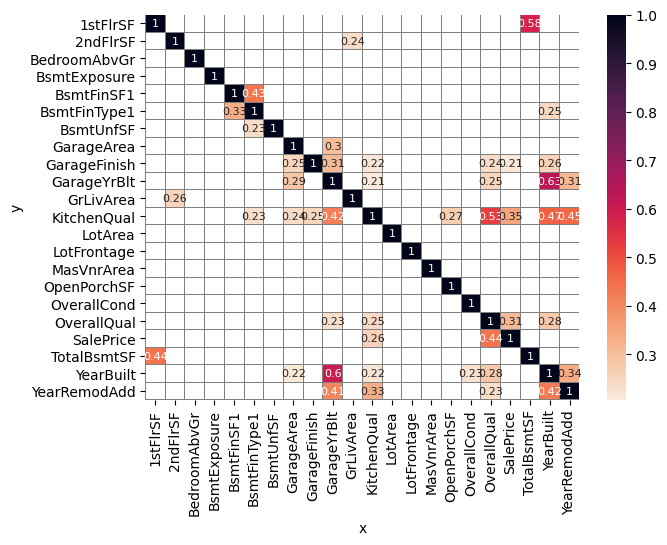

In [8]:
DisplayCorrAndPPS(df_corr_pearson=df_corr_pearson,
                  df_corr_spearman=df_corr_spearman, 
                  pps_matrix=pps_matrix,
                  CorrThreshold=0.5, PPS_Threshold=0.2,
                  figsize=(7,5), font_annot=8)

Interpretation: 

- when looking at the first plot we see that the SalePrice corrolate moderately with 8 variables.
- when looking at the second plot we see that the SalePrice corrolate moderately with 7 variables.
- when looking at the last plot we see that the SalePrice has relative strong level of predictive power with 2 variables so we will considere them.

## Variables Selection:

From what we saw so far, we are going to study the following variables. We will investigate if:
1. The rates the overall material and finish of the house ['OverallQual'] impacts the SalePrice.
2. The size of the living area in square feet ['GrLivArea'] impacts the SalePrice, 
3. The Size of garage in square feet ['GarageArea'] impacts the SalePrice, 
4. The size of the first Floor in square feet ['1stFlrSF'] impacts the SalePrice, 
5. The total square feet of basement area ['TotalBsmtSF'] impacts the SalePrice,
6. The original construction date ['YearBuilt'] impacts the SalePrice,
7. The Year garage was built ['GarageYrBlt'] impacts the SalePrice,
8. Th Remodel date ['YearRemodAdd'] impacts the SalePrice,
9. The Kitchen quality['KitchenQual'] impacts the SalePrice.

In [9]:
vars_to_study = ['OverallQual', 'GrLivArea', 'GarageArea', '1stFlrSF', 'TotalBsmtSF', 'YearBuilt', 'GarageYrBlt', 'YearRemodAdd', 'KitchenQual']
df[vars_to_study].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 9 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   OverallQual   1460 non-null   int64  
 1   GrLivArea     1460 non-null   int64  
 2   GarageArea    1460 non-null   int64  
 3   1stFlrSF      1460 non-null   int64  
 4   TotalBsmtSF   1460 non-null   int64  
 5   YearBuilt     1460 non-null   int64  
 6   GarageYrBlt   1460 non-null   float64
 7   YearRemodAdd  1460 non-null   int64  
 8   KitchenQual   1460 non-null   object 
dtypes: float64(1), int64(7), object(1)
memory usage: 102.8+ KB


On the selected variables, we have 8 numericals and 1 categorical.

---

# EDA on selected variables

We are going to do another EDA (Exploratory Data Analysis) to better understand the data on the selected variables with SalePrice as target.

In [10]:
df_eda = df.filter(vars_to_study + ['SalePrice'])
df_eda.head()

,OverallQual,GrLivArea,GarageArea,1stFlrSF,TotalBsmtSF,YearBuilt,GarageYrBlt,YearRemodAdd,KitchenQual,SalePrice
0,7,1710,548,856,856,2003,2003.0,2003,Gd,208500
1,6,1262,460,1262,1262,1976,1976.0,1976,TA,181500
2,7,1786,608,920,920,2001,2001.0,2002,Gd,223500
3,7,1717,642,961,756,1915,1998.0,1970,Gd,140000
4,8,2198,836,1145,1145,2000,2000.0,2000,Gd,250000


First we want to know more about SalePrice:

In [11]:
df['SalePrice'].describe()

count      1460.000000
mean     180921.195890
std       79442.502883
min       34900.000000
25%      129975.000000
50%      163000.000000
75%      214000.000000
max      755000.000000
Name: SalePrice, dtype: float64

And visualise and save the distribution:

In [12]:
import os
try:
  os.makedirs(name='docs/plots') # create docs/plots folder
except Exception as e:
  print(e)

[Errno 17] File exists: 'docs/plots'


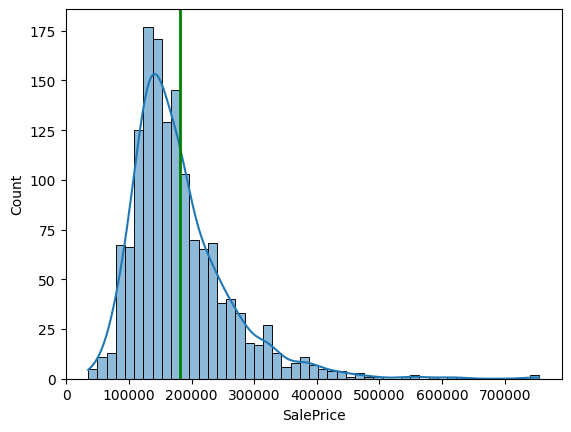

In [13]:
def plot_saleprice():
    sns.histplot(df['SalePrice'], kde=True)
    plt.axvline(x=df['SalePrice'].mean(), color='g', linewidth=2)
    plt.savefig(f'docs/plots/hist_plot_saleprice.png', bbox_inches='tight')

plot_saleprice()

We can clearly see that most of the houses SalePrice is before 400,000 dollars and the mean is around to 180,921 dollars as per green line.

Then we plot the distribution (numerical and categorical) by SalePrice:

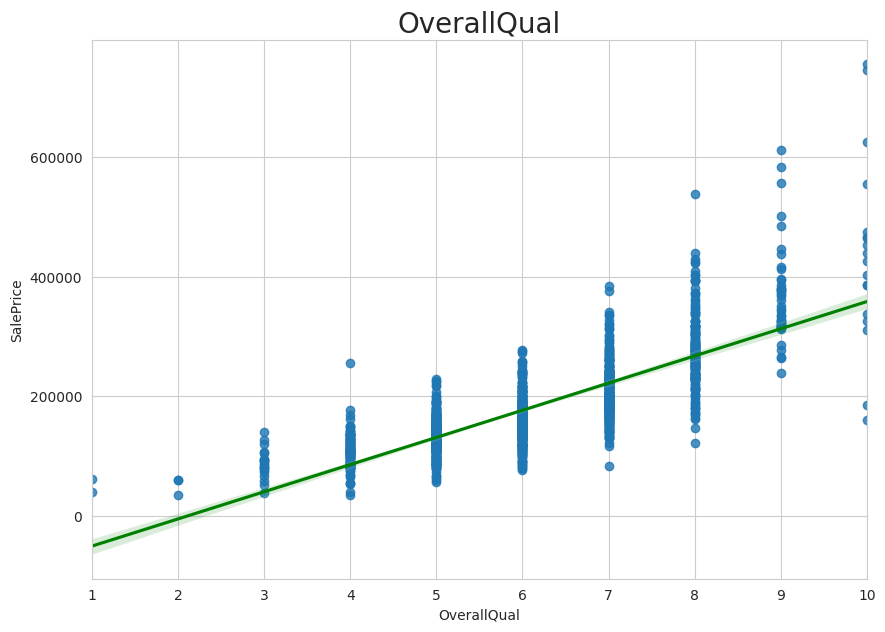

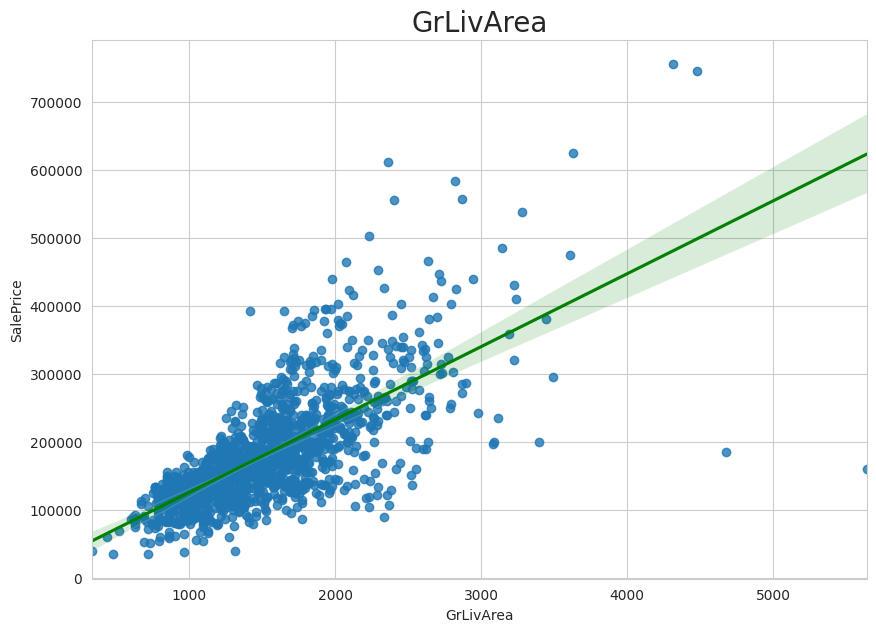

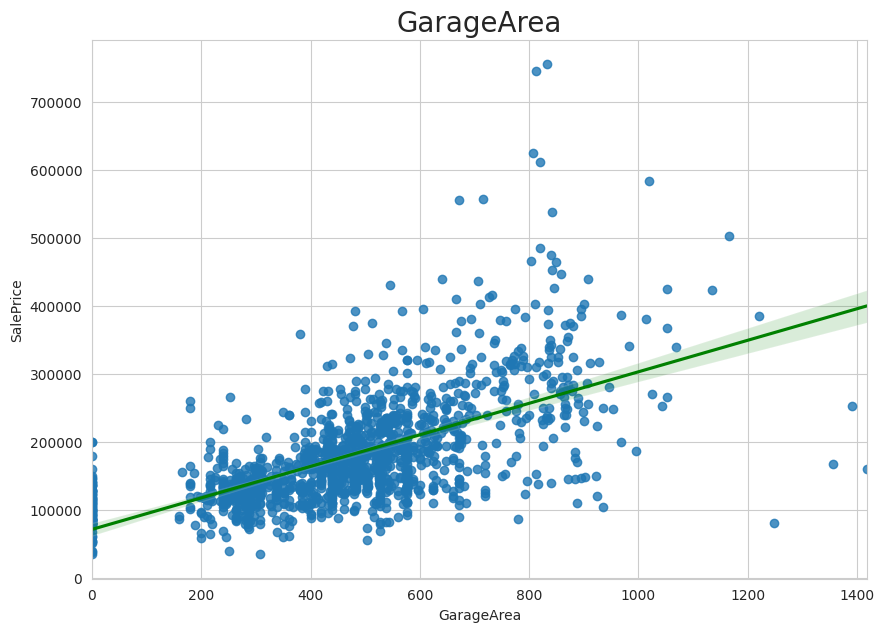

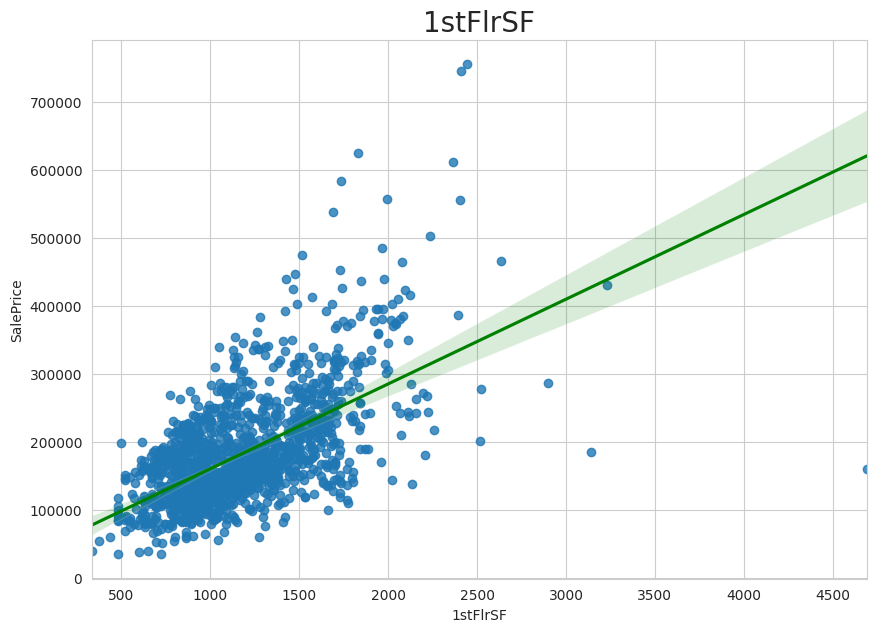

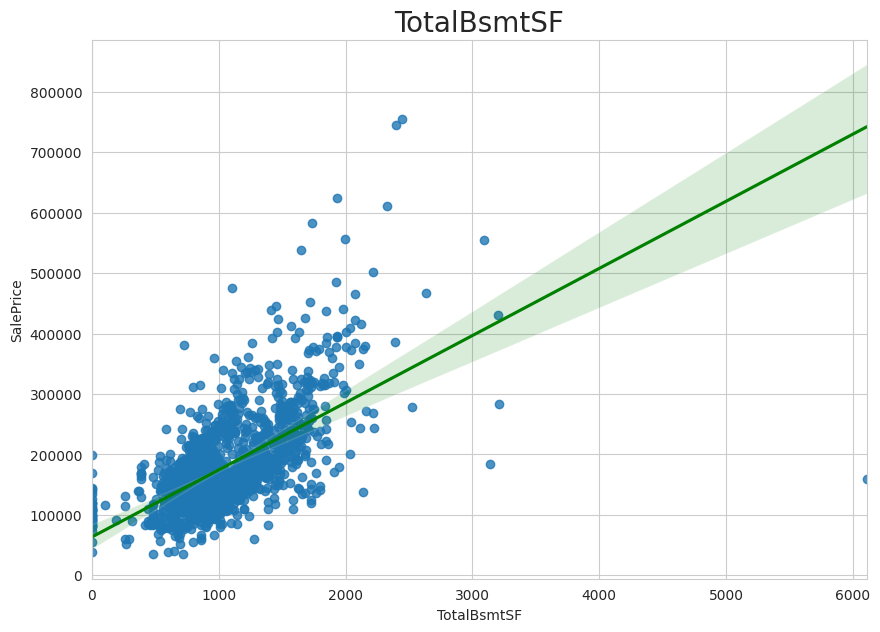

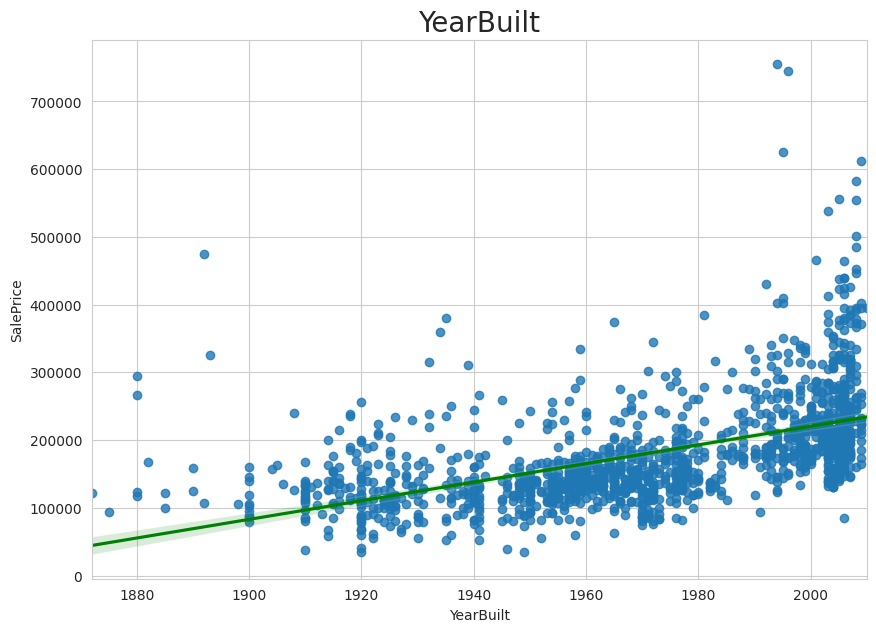

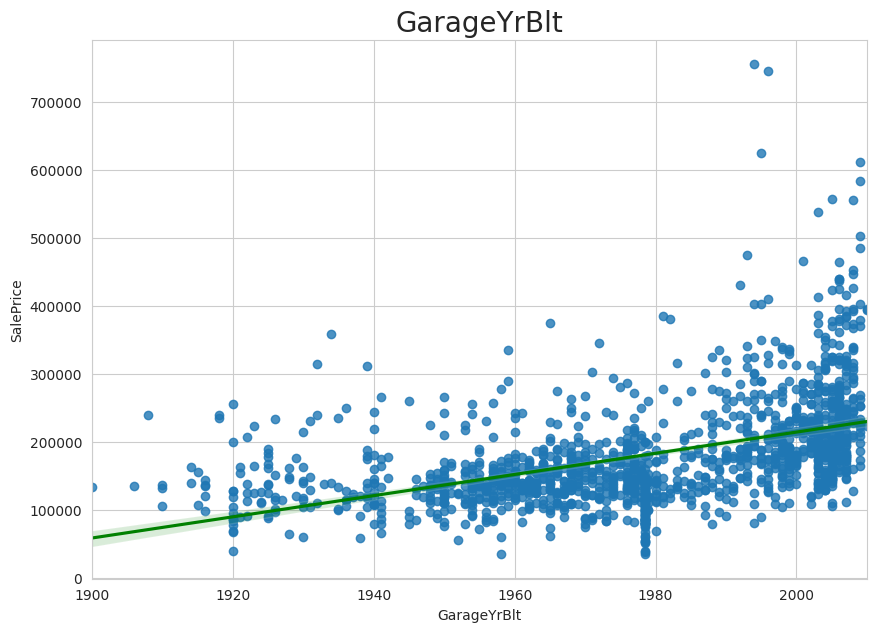

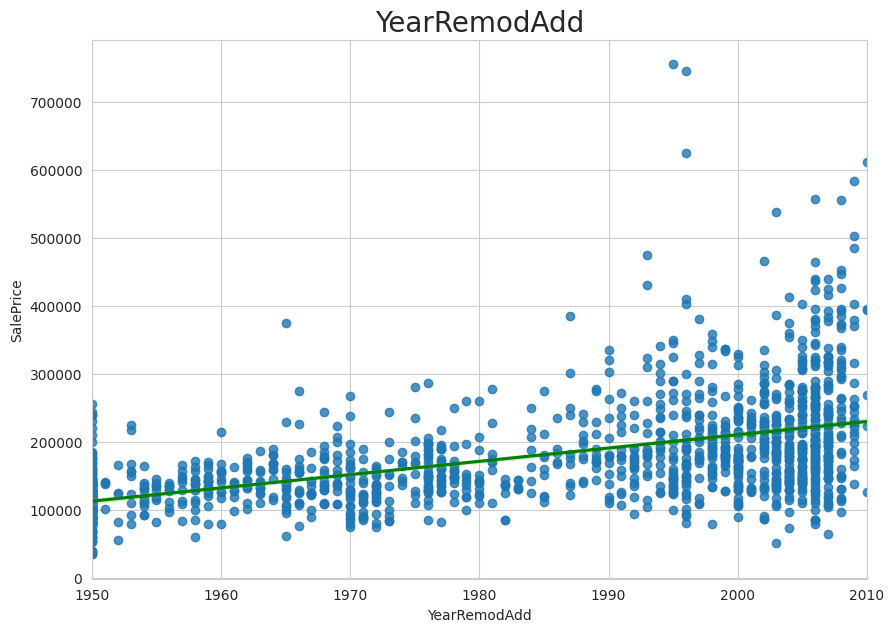

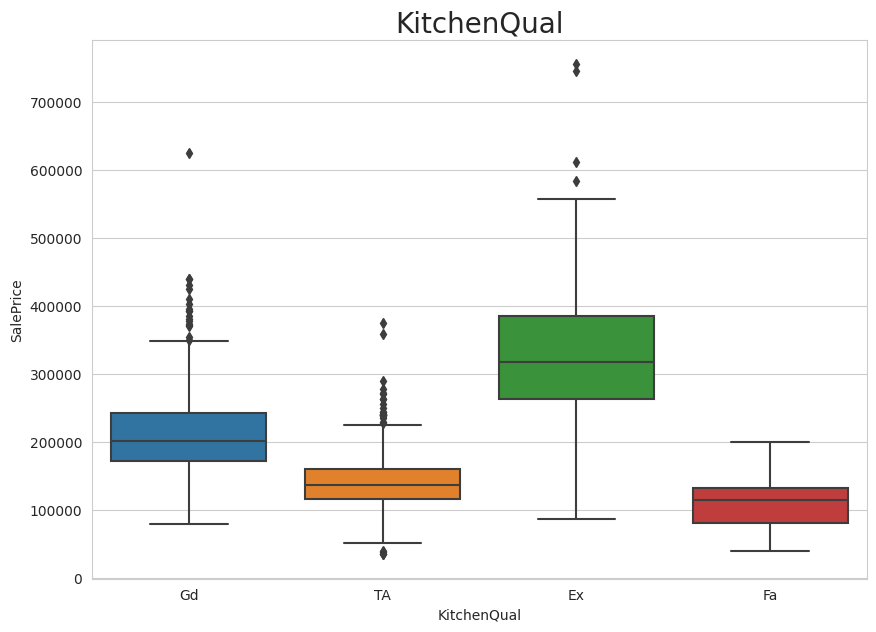

In [22]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')

categorical_var = 'KitchenQual'
target_var = 'SalePrice'


def plot_numerical(df, col, target_var):
  plt.figure(figsize=(10, 7))
  sns.regplot(data=df, x=col, y=target_var, line_kws={"color": "green"})
  plt.title(f"{col}", fontsize=20)
  plt.savefig(f'docs/plots/{col}vs{target_var}.png', bbox_inches='tight')

def plot_categorical(df, categorical_var, target_var):
  plt.figure(figsize=(10, 7))
  sns.boxplot(data=df, x=categorical_var, y=target_var)  
  plt.title(f"{categorical_var}", fontsize=20)
  plt.savefig(f'docs/plots/{categorical_var}vs{target_var}.png', bbox_inches='tight')

# Only the last vars_to_study is a categorical variable
for col in vars_to_study[:-1]:
  plot_numerical(df_eda, col, target_var)
  print("\n\n")

plot_categorical(df_eda, categorical_var, target_var)

* At first glance from this correlation strudy, we can see that we have a narrow confidence interval bands on some regplots. This means that the regression line is relatively more precise and has less uncertainty. The features that corrolate with the SalePrice are: ['OverallQual'], ['GarageArea'], ['YearBuilt'], ['GarageYrBlt'] and ['YearRemodAdd'].
* Then we can see that other features have an acceptable narrow confidence interval bands until it which became wide when the regression line reach the SalePrice of 350,000 dollars. In fact, a wider confidence interval band indicates more uncertainty in the regression line, and SalePrice could vary more from the true values. The features are : ['GrLivArea'], ['1stFlrSF'] and ['TotalBsmtSF'].
* For the ['KitchenQual'] we can see that the category `Po` (Poor) is not represented at all. For the 4 other features, we can see that the quality of the Kitchen corrolate with the SalePrice.

---

# Conclusions

1. Summary

* ['OverallQual'], ['GarageArea'], ['YearBuilt'], ['GarageYrBlt'] and ['YearRemodAdd'] have high correlation with SalePrice and a narrow confidence interval bands along the entire regression line.
* ['GrLivArea'], ['1stFlrSF'] and ['TotalBsmtSF'] have high correlation with SalePrice. However the confidence interval bands might be narrow at the start of the regression line, it widden after a SalePrice of 350,000 dollars. We can still consider these features ss we saw on the SalePrice distribution, most of the houses have a Sale Price inferior. The other reason we can consider the ['GrLivArea'], ['1stFlrSF'] and ['TotalBsmtSF'] is that we can see from the data that houses are generaly small.
* ['KitchenQual'] has a high correlation too, even with a missing category (that would be a limit). For the 4 other features, we can see that the quality of the Kitchen corrolate with the SalePrice.

2. Requirement 1 (BR1) and Hypothesys 1 & 2 

BR1 : As the client is interested in discovering how the house attributes correlate with the sale price. We saw that the following attributes have a high correlation: ['OverallQual'], ['GarageArea'], ['YearBuilt'], ['GarageYrBlt'], ['YearRemodAdd'], ['GrLivArea'], ['1stFlrSF'], ['TotalBsmtSF'] and ['KitchenQual'].

Hypothesys 1: we can validate the first hypothesys as we can see that the size, the quality of the house and the year it was built impact the sale price as follow : 
* size: ['GrLivArea'], ['1stFlrSF'] and ['TotalBsmtSF'].
* quality: ['OverallQual'] and ['KitchenQual'].
* built year:  ['YearBuilt'].

Hypothesis 2: we also confirm that the price of a house correlates strongly with other different features: ['GarageYrBlt'], ['GarageArea'] and ['YearRemodAdd']. We can see that the Garage and remodel date are important features in the area of Ames, Iowa that we found thanks to the Correlation study and PPS analysis.
